# Running APES on .raw files

This notebook contains an walk through of the "Fish_Krill" example script provided in the [APESExamples repository](https://github.com/ElOceanografo/APESExamples/tree/main) which applies the Bayesian inversion model using the PobabilisticEchoInversion package in Julia using simulated mixed assemblages of krill and fish. For additional details, see see [Urmy et al., 2023](https://doi.org/10.1093/icesjms/fsad102).

### 1. Set up environment

Activate and load Julia environment and associated packages

In [5]:
# Activate environment and import packages
using Pkg
Pkg.activate()

using ProbabilisticEchoInversion
using Turing
using Random
using SDWBA
using Plots, StatsPlots, Plots.PlotMeasures
using DataFrames, DataFramesMeta

include(joinpath(@__DIR__, "../src/bubbles.jl"))

# Set random seed for reproducibility when generating simulated volume backscattering
Random.seed!(123);

  Activating project at `/opt/julia/environments/v1.11`


### 2. Define frequency domain and scattering models

This analysis will compare inversion results from narrowband and broadband datasets. TS responses for fish and krill are modeled using the target_strength function in the SDWBA Julia package.

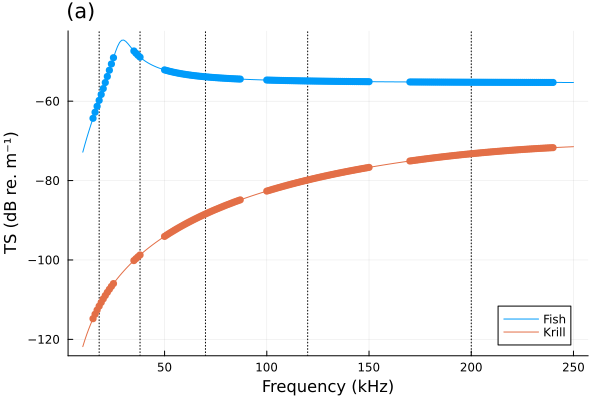

In [10]:
# Define frequency ranges for analysis
freqs_bb = [15:25; 35:38; 50:87; 100:150; 170:240]  # Broadband frequencies (Hz)
freqs_nb = [18, 38, 70, 120, 200]                   # Narrowband frequencies (Hz)
freqs_plot = 10:250                                 # Frequency range for plotting (Hz)
i_nb = indexin(freqs_nb, freqs_bb);                  # Find indices of narrowband frequencies in broadband array

# Define parameters for fish and krill models
depth = 200.0       # Water depth in meters
a = 0.0005          # Equivalent spherical radius for fish bubble (m)
δ = 0.3             # Damping parameter for fish bubble
fish = Bubble(a, depth=depth, δ=δ)  # Create fish bubble model
krill = resize(Models.krill_mcgeehee, 0.025)  # Create krill model, resized to 25mm

# Set material properties for krill based on literature values
# EBS/GOA average values from Lucca et al. 2021
krill.g .= 1.019    # Density contrast (ratio of organism density to water density)
krill.h .= 1.032    # Sound speed contrast (ratio of sound speed in organism to sound speed in water)

# Define functions to calculate target strength (TS) for fish and krill
ts_fish(freq) = target_strength(fish, freq*1e3)  # Convert kHz to Hz for fish TS calculation
ts_krill(freq) = target_strength(krill, freq*1e3, 1470)  # Calculate krill TS with sound speed 1470 m/s

# Calculate target strengths and backscattering cross-sections
TS_sim = [ts_fish.(freqs_bb) ts_krill.(freqs_bb)]  # TS at broadband frequencies for both organisms
Σ_sim = exp10.(TS_sim / 10)                        # Convert from dB to linear units
TS_plot = [ts_fish.(freqs_plot) ts_krill.(freqs_plot)]  # TS at plot frequencies
Σ_plot = exp10.(TS_plot / 10)                           # Convert from dB to linear units

# Create plot (a): Target Strength vs Frequency
tsplot = plot(freqs_plot, TS_plot, label=["Fish" "Krill"], legend=:bottomright,
    xlabel="Frequency (kHz)", ylabel="TS (dB re. m⁻¹)", title="(a)", titlealign=:left);
vline!(tsplot, freqs_nb, linestyle=:dot, color=:black, label="");  # Add vertical lines at narrowband frequencies
scatter!(tsplot, freqs_bb, TS_sim, color=[1 2], label="", markerstrokewidth=0)  # Add scatter points for broadband frequencies
scatter!(tsplot, freqs_nb, ts_fish.(freqs_nb), color=[1 2], label="", markerstrokewidth=0)  # Add scatter points for broadband frequencies

### 3a. Define the simulation scnearios

This example compares three scenarios, krill-dominated, mixed, and fish-dominated, defined by their numerical densities per cubic meter. 

In [15]:
# Define numerical density scenarios (organisms per cubic meter)
# Format: [fish_density, krill_density]
N1 = [0.001, 1e3]   # Krill-dominated scenario
N2 = [0.2, 4e2]     # Mixed scenario
N3 = [0.5, 10]      # Fish-dominated scenario
scenarios = [N1, N2, N3];

### 3b. Generate simulated volume backscattering and priors (input data)

Based on the numberical abundances defined above, the volume backscatter for narrowband (Sv) and broadband (Sv(f)) is estimated based on the previously defined TS curves.

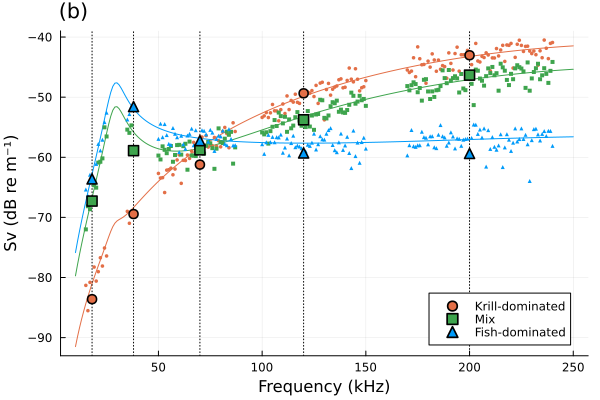

In [61]:
# Generate simulated volume backscattering data for each scenario
svs = map(scenarios) do N
    TS = TS_sim
    Σ = exp10.(TS_sim / 10)
    sv_pred = Σ * N   # Calculate predicted volume backscattering by multiplying by numerical density
    σ = sv_pred / sqrt(π/2)  # Convert mean sv to Rayleigh parameter σ
    # Generate 3 random realizations from Rayleigh distribution and take the mean
    return mean(rand.(Rayleigh.(σ)) for _ in 1:3)
end

Svs = [10log10.(sv) for sv in svs]  # Convert to dB
svs_nb = [sv[i_nb] for sv in svs]   # Extract narrowband frequencies
Svs_nb = [Sv[i_nb] for Sv in Svs]   # Extract narrowband frequencies in dB

# Calculate theoretical volume backscattering strength for plotting
Svs_plot = [10log10.(Σ_plot * N) for N in scenarios]
pal = [2 3 1]  # Color palette for different scenarios

# Create plot (b): Volume backscattering strength vs Frequency
svplot = plot(freqs_plot, Svs_plot, legend=:bottomright, label="", c=pal,
    xlabel="Frequency (kHz)", ylabel="Sv (dB re m⁻¹)", title="(b)", titlealign=:left);
vline!(svplot, freqs_nb, linestyle=:dot, color=:black, label="");  # Add vertical lines at narrowband frequencies
scatter!(svplot, freqs_bb, Svs, legend=:bottomright, label="", c=pal, markershape=[:circle :square :utriangle],
    markerstrokewidth=0, markersize=2);  # Add scatter points for broadband frequencies
scatter!(svplot, freqs_nb, Svs_nb, color=pal, markershape=[:circle :square :utriangle], 
    markersize=5, markerstrokewidth=2, labels=["Krill-dominated" "Mix" "Fish-dominated"])  # Add narrowband points

The simulated Sv data is assembled into tuples for the model. Below you can see the narrowband data as an example:

In [71]:
# Prepare data for model fitting
data_bb = [(backscatter=Sv, freqs=freqs_bb, coords=(depth,))
    for Sv in Svs]  # Broadband data
data_nb = [(backscatter=data.backscatter[i_nb], freqs=freqs_bb[i_nb], coords=(depth,))
    for data in data_bb];  # Narrowband data

for i in 1:3
    print("Narrowband scencario $(i):\n$(data_nb[i])\n")
end

Narrowband scencario 1:
(backscatter = [-83.60492008685827, -69.44403593058307, -61.21916993080567, -49.356804136253615, -43.026509113400124], freqs = [18, 38, 70, 120, 200], coords = (200.0,))
Narrowband scencario 2:
(backscatter = [-67.2839157586931, -58.89589755042895, -58.76784676494584, -53.766398097859785, -46.329172178837354], freqs = [18, 38, 70, 120, 200], coords = (200.0,))
Narrowband scencario 3:
(backscatter = [-63.60521526092592, -51.56597480617505, -57.23546589237078, -59.28394813079614, -59.36828717032217], freqs = [18, 38, 70, 120, 200], coords = (200.0,))


Then define the priors, which in this case is an arbitrary mix of krill and fish densities.

In [25]:
# Define prior distribution parameters
μprior = [0.1, 200]  # Prior means for fish and krill numerical densities
params_bb = (TS_const = ts_krill.(freqs_bb), δ = δ, μprior=μprior)  # Parameters for broadband model
params_nb = (TS_const = ts_krill.(freqs_nb), δ = δ, μprior=μprior);  # Parameters for narrowband model

### 4. Define and run the inversion model

In [72]:
# Define Bayesian probabilistic model using Turing.jl
@model function echomodel(data, params)
    depth = data.coords[end]
    # Sample bubble radius from truncated normal distribution
    a ~ truncated(Normal(5e-4, 3.5e-4), 0.0001, 0.001)
    # Create bubble model with sampled radius
    b = Bubble(a, depth=data.coords[1], δ=params.δ)
    # Calculate target strength for fish at each frequency
    TS_fish = map(f -> target_strength(b, f.*1e3), data.freqs)
    # Combine fish and krill target strengths
    TS = [TS_fish params.TS_const]
    # Convert to linear backscattering cross-section
    Σbs = exp10.(TS ./ 10)
    # Sample log numerical densities from normal distributions
    logn ~ arraydist(Normal.(log10.(params.μprior), 2.0))
    n = exp10.(logn)
    # Calculate predicted volume backscattering strength
    Sv_pred = 10log10.(Σbs * n)
    # Sample observation error
    ϵ ~ Exponential(1.0)
    # Likelihood: observed backscatter follows normal distribution around predictions
    data.backscatter .~ Normal.(Sv_pred, ϵ)
    # Return posterior predictive distribution across all frequencies
    return 10log10.(Σ_plot * n) .+ ϵ .* randn(size(Σ_plot, 1))
end;

Execute the model (`echomodel`) using the simulated Sv data (`sv_nb`, `sv_bb`) and starting parameters (`params_nb`, `params_bb`)

In [73]:
# Set up MCMC sampler configuration
solver = MCMCSolver(sampler=NUTS(0.8), nchains=4, nsamples=2500, kwargs=(progress=true,))

# Fit models to each scenario, for both narrowband and broadband data
chains = map(zip(data_nb, data_bb)) do data
    sv_nb, sv_bb = data
    chain_nb = solve(sv_nb, echomodel, solver, params_nb)  # Fit narrowband model
    chain_bb = solve(sv_bb, echomodel, solver, params_bb)  # Fit broadband model
    return (nb = chain_nb, bb = chain_bb)
end;

Sampling (Chain 1 of 4): 100%|██████████████████████████| Time: 0:00:01
Sampling (Chain 2 of 4): 100%|██████████████████████████| Time: 0:00:01
Sampling (Chain 3 of 4): 100%|██████████████████████████| Time: 0:00:01
Sampling (Chain 4 of 4): 100%|██████████████████████████| Time: 0:00:01
Sampling (Chain 1 of 4): 100%|██████████████████████████| Time: 0:00:03
Sampling (Chain 2 of 4): 100%|██████████████████████████| Time: 0:00:05
Sampling (Chain 3 of 4): 100%|██████████████████████████| Time: 0:00:04
Sampling (Chain 4 of 4): 100%|██████████████████████████| Time: 0:00:05
Sampling (Chain 1 of 4): 100%|██████████████████████████| Time: 0:00:00
Sampling (Chain 2 of 4): 100%|██████████████████████████| Time: 0:00:00
Sampling (Chain 3 of 4): 100%|██████████████████████████| Time: 0:00:00
Sampling (Chain 4 of 4): 100%|██████████████████████████| Time: 0:00:00
Sampling (Chain 1 of 4): 100%|██████████████████████████| Time: 0:00:01
Sampling (Chain 2 of 4): 100%|██████████████████████████| Time: 

### Model output

In all output below, n[1] is fish and n[2] is krill.

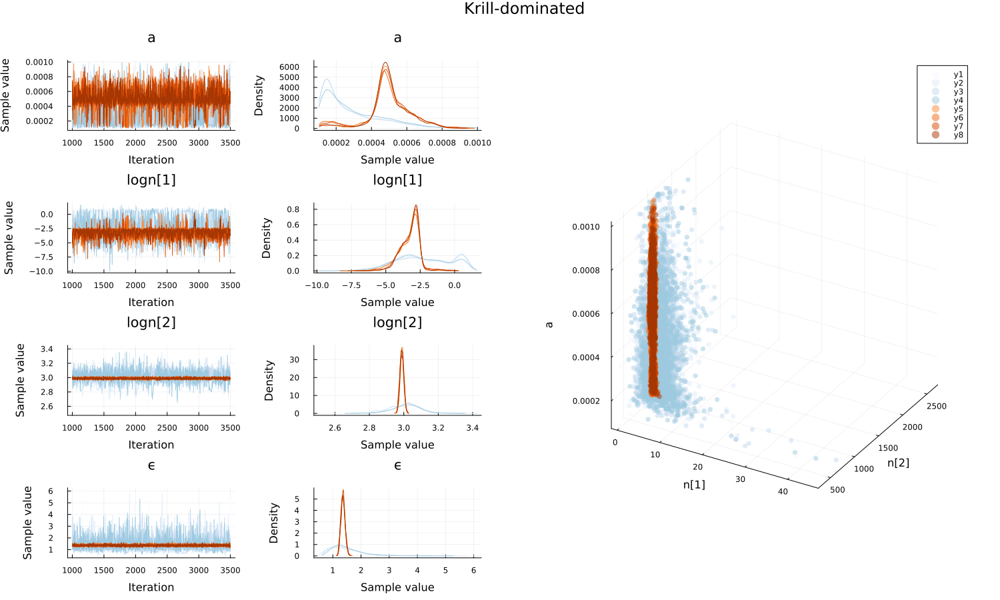

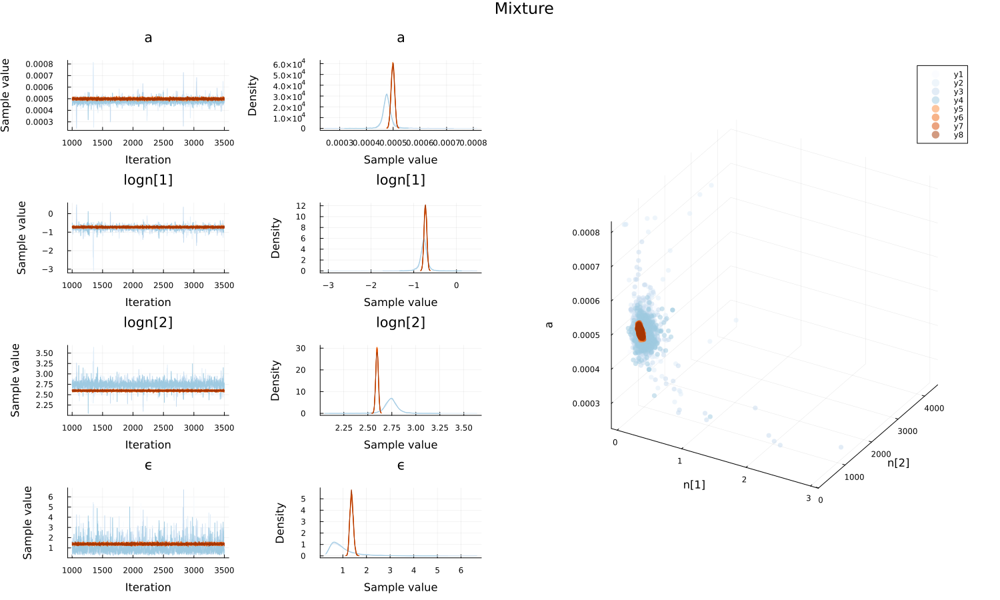

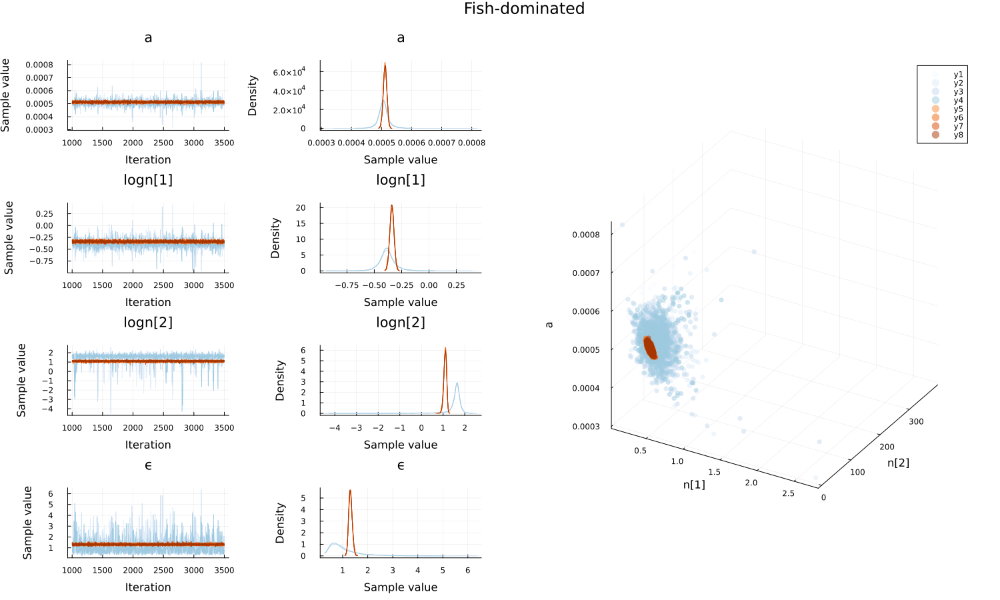

In [46]:
# Create diagnostic plots for each scenario
scenario= ["Krill-dominated" "Mixture" "Fish-dominated"]
for i in 1:3
    chn_nb = chains[i].nb
    chn_bb = chains[i].bb
    # Trace plots for all parameters
    p1 = plot(chn_nb, palette=:Blues);
    plot!(p1, chn_bb, palette=:Oranges);
    # 3D scatter plot of parameter posterior samples
    p2 = scatter(exp10.(chn_nb[Symbol("logn[1]")]), exp10.(chn_nb[Symbol("logn[2]")]), chn_nb[:a],
        xlabel="n[1]", ylabel="n[2]", zlabel="a", markerstrokewidth=0, alpha=0.5, palette=:Blues) ;
    scatter!(p2, exp10.(chn_bb[Symbol("logn[1]")]), exp10.(chn_bb[Symbol("logn[2]")]), chn_bb[:a],
        markerstrokewidth=0, alpha=0.5, palette=:Oranges);
    d2 = plot(p1, p2, size=(1500, 900), margin=20px,plot_title=scenario[i])
    display(d2)
end;

In [31]:
# Set up for posterior analysis plots
titles = ["Krill-dominated", "Mixture", "Fish-dominated"]
xlimits = [[1e-6, 1], [1e-6, 1], [1e-6, 1]]  # Limits for fish density axis
ylimits = [[0, 2000], [0, 2000], [0, 200]]   # Limits for krill density axis

# Create posterior distribution plots for each scenario
post_plots = map(enumerate(chains)) do (i, chn)
    # Extract MCMC samples
    a_nb = reshape(chn.nb[:a], :, 1)  # Bubble radius from narrowband model
    n_nb = exp10.(reshape(Array(group(chn.nb, :logn)), :, 2))  # Numerical densities from narrowband model
    a_bb = reshape(chn.bb[:a], :, 1)  # Bubble radius from broadband model
    n_bb = exp10.(reshape(Array(group(chn.bb, :logn)), :, 2))  # Numerical densities from broadband model

    # Plot posterior distribution of bubble radius (ESR)
    a_plot = plot(truncated(Normal(0.5, 0.35), 0.01, 1.5), 
        fill=(0, "#aaaaaa"), color="#aaaaaa", label="Prior")
    density!(a_plot, 1e3*a_nb, fill=true, alpha=0.75, label="Narrowband",
        xlabel="ESR (mm)", ylabel="PDF", title=titles[i], color=1,
        legend = i==3 ? :topright : :none)
    density!(a_plot, 1e3*a_bb, fill=true, alpha=0.75, label="Broadband", color=2)
    vline!(a_plot, [1e3*a], color=:black, linestyle=:dot, label="")  # True value
    ylims!(a_plot, (0, 15))

    # Plot joint posterior distribution of numerical densities
    ff =  range(xlimits[i]..., length=100)  # Fish density range
    kk =  range(ylimits[i]..., length=100)  # Krill density range
    # Calculate prior density
    prior = [prod(pdf.(Normal.(log10.(μprior), 1.0), log10.([x, y])))
        for x in ff, y in kk]
    n_plot = contourf(ff, kk, prior', c=:Greys_3, alpha=0.1, legend=:none)

    # Plot posterior samples
    n_plot = scatter!(n_nb[:, 1], n_nb[:, 2], markerstrokewidth=0, alpha=0.25, 
        legend=false, markersize=1.5, color=1,
        xlabel="Fish m⁻³", ylabel="Krill m⁻³")
    scatter!(n_plot, n_bb[:, 1], n_bb[:, 2], markerstrokewidth=0, alpha=0.25,
        markersize=1.5, color=2)
    # Add true values
    vline!(scenarios[i][[1]], color=:black, linestyle=:dot)
    hline!(scenarios[i][[2]], color=:black, linestyle=:dot)
    xlims!(n_plot, xlimits[i]...)
    ylims!(n_plot, ylimits[i]...)
    post_plot = plot(a_plot, n_plot, layout=(2,1))
end

d3 = plot(post_plots..., layout=(1, 3), size=(900, 500), dpi=350, margin=15px)
display(d3)

3-element Vector{Plots.Plot{Plots.GRBackend}}:
 Plot{Plots.GRBackend() n=9}
 Plot{Plots.GRBackend() n=9}
 Plot{Plots.GRBackend() n=9}

In [56]:
comparison

Row,scenario,bandwidth,a,scatterer,n,ntrue,error,rel_error
,Int64,String,Float64,String,Float64,Float64?,Float64,Float64
1,1,broadband,0.000500016,fish,0.00533193,0.001,0.00433193,4.33193
2,1,narrowband,0.00028426,fish,1.01516,0.001,1.01416,1014.16
3,2,broadband,0.000498915,fish,0.188196,0.2,-0.0118036,-0.0590179
4,2,narrowband,0.000477679,fish,0.175838,0.2,-0.0241624,-0.120812
5,3,broadband,0.000511897,fish,0.458739,0.5,-0.0412607,-0.0825214
6,3,narrowband,0.000506533,fish,0.421471,0.5,-0.0785285,-0.157057
7,1,broadband,0.000500016,krill,975.035,1000.0,-24.9647,-0.0249647
8,1,narrowband,0.00028426,krill,1037.07,1000.0,37.0711,0.0370711
9,2,broadband,0.000498915,krill,394.403,400.0,-5.59718,-0.013993


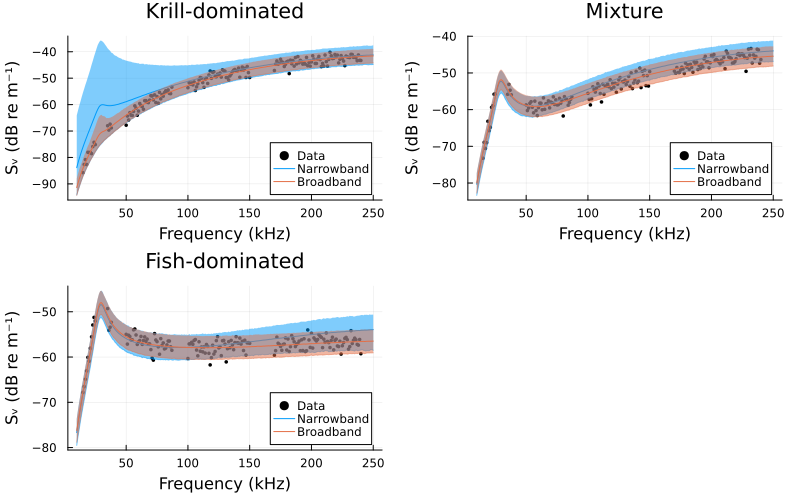

In [47]:
# Convert MCMC chains to DataFrames for analysis
df = map(enumerate(chains)) do tup
    i, chn = tup
    # Process narrowband results
    dfnb = DataFrame(chn.nb)
    dfnb[!, :bandwidth] .= "narrowband"
    # Process broadband results
    dfbb = DataFrame(chn.bb)
    dfbb[!, :bandwidth] .= "broadband"
    # Combine and add scenario identifier
    df = vcat(dfbb, dfnb)
    df[!, :scenario] .= i
    return df
end
df = vcat(df...)  # Combine all scenarios

# Create DataFrame with true values for comparison
truth = DataFrame(scenario = repeat(1:3, inner=2), 
                  scatterer = repeat(["fish", "krill"], outer=3),
                  ntrue=vcat(scenarios...))

# Compare estimated vs true values
comparison = @chain df begin
    select(:scenario, :bandwidth, :a, "logn[1]" => :lognfish, "logn[2]" => :lognkrill)
    @by([:scenario, :bandwidth],
        :a = mean(:a),
        :fish = mean(exp10.(:lognfish)),
        :krill = mean(exp10.(:lognkrill)))
    DataFrames.stack([:fish, :krill], variable_name=:scatterer, value_name=:n)
    leftjoin(truth, on=[:scenario, :scatterer])
    @transform(:error = :n .- :ntrue)
    @transform(:rel_error = :error ./ :ntrue)
end

# Calculate MCMC convergence diagnostics (R-hat statistic)
rhats = map(enumerate(chains)) do tup
    i, chns = tup
    df_nb = chns.nb |> ess_rhat |> DataFrame |> df -> unstack(df[:, [:parameters, :rhat]], :parameters, :rhat)
    df_nb[!, :bandwidth] .= "Narrowband"
    df_bb = chns.bb |> ess_rhat |> DataFrame |> df -> unstack(df[:, [:parameters, :rhat]], :parameters, :rhat)
    df_bb[!, :bandwidth] .= "Broadband"
    [df_nb; df_bb]
end
rhats = vcat(rhats...)

# Generate posterior predictive distributions
ppreds = map(1:3) do i
    (bb = generated_quantities(echomodel(data_bb[i], params_bb), chains[i].bb) |> vec,
     nb = generated_quantities(echomodel(data_nb[i], params_nb), chains[i].nb) |> vec)
end

# Create posterior predictive plots for each scenario
post_pred_plots = map(1:3) do i
    p = scatter(freqs_bb, Svs[i], markersize=2, color=:black, 
        xlabel="Frequency (kHz)", ylabel="Sᵥ (dB re m⁻¹)",
        title=titles[i], label="Data", legend=:bottomright)
    # Plot narrowband posterior predictive with 95% credible intervals
    plot!(p, freqs_plot, vec(mapslices(x -> quantile(x, 0.025), hcat(ppreds[i].nb...), dims=2)),
        fillrange=vec(mapslices(x -> quantile(x, 0.975), hcat(ppreds[i].nb...), dims=2)),
        alpha=0.5, color=1, label="")
    plot!(p, freqs_plot, mean(ppreds[i].nb), color=1, label="Narrowband")
    # Plot broadband posterior predictive with 95% credible intervals
    plot!(p, freqs_plot, vec(mapslices(x -> quantile(x, 0.025), hcat(ppreds[i].bb...), dims=2)),
        fillrange=vec(mapslices(x -> quantile(x, 0.975), hcat(ppreds[i].bb...), dims=2)),
        alpha=0.5, color=2, label="")
    plot!(p, freqs_plot, mean(ppreds[i].bb), color=2, label="Broadband")
    return p
end
# Combine posterior predictive plots and save
d4 = plot(post_pred_plots..., size=(800, 500), margin=10px)
#savefig(joinpath(@__DIR__, "plots/posterior_predictive.png"))
display(d4)